In [1]:
import os
import datetime

import numpy as np
import scipy
import fiona
import statistics
import math

import pandas as pd
import geopandas as gpd
from shapely import wkt
from shapely.geometry import LineString, shape, mapping, Point, Polygon, MultiPolygon
from shapely.ops import cascaded_union

from scipy.stats import linregress, norm

import matplotlib.pyplot as plt
from matplotlib import colors, cm, style
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from descartes import PolygonPatch
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.gridspec as gridspec

import contextily as cx

import osmnx as ox
import networkx as nx

import pysal as ps
import libpysal as lps
import esda
import seaborn as sns

from tabulate import tabulate
from termcolor import colored

/Users/roosteeuwen/opt/anaconda3/envs/greenspace_accessibility/lib/python3.7/site-packages/pysal/__init__.py:65: VisibleDeprecationWarning: PySAL's API will be changed on 2018-12-31. The last release made with this API is version 1.14.4. A preview of the next API version is provided in the `pysal` 2.0 prelease candidate. The API changes and a guide on how to change imports is provided at https://migrating.pysal.org
  ), VisibleDeprecationWarning)


In [2]:
style.use('seaborn-white')
input_output_folder = 'data'

# Parameters

In [3]:
local_crs = 'EPSG:28992'

In [4]:
trip_distances = [300, 500, 800]
trip_colors = ['#78c679', '#c2e699', '#ffffcc']

my_green = '#a4cc90'
my_pink = '#af80ec'
my_grey = 'lightgrey'
my_highlight = 'yellow'
my_outline = 'darkgrey'

# green - blue
# seq_cmap = LinearSegmentedColormap.from_list('mycmap', [(0, '#a8ddb5'), (0.25, '#7bccc4'), (0.5, '#4eb3d3'), (0.75, '#2b8cbe'), (1, '#08589e')])
# contr_cmap = LinearSegmentedColormap.from_list('mycmap', [(0, '#e0e0e0'), (0.5, '#999999'), (1, '#4d4d4d')])

# orange-purple
seq_cmap = plt.get_cmap('flare')
contr_cmap = plt.get_cmap('Greys')
my_neutral = seq_cmap(0.0)

In [5]:
quick_plot = False

# Load data

## Amsterdam

In [6]:
ams_sub_folder = 'Amsterdam_14Apr2022'

In [7]:
ams_place = gpd.read_file(os.path.join(input_output_folder, ams_sub_folder, 'place.geojson'), crs=local_crs)

In [8]:
ams_greenspaces = gpd.read_file(os.path.join(input_output_folder, ams_sub_folder, 'greenspace_accessibility.geojson'), crs=local_crs)

In [9]:
ams_residences = gpd.read_file(os.path.join(input_output_folder, ams_sub_folder, 'residences_population.geojson'), crs=local_crs)
ams_residences['pop_count'] = ams_residences['pop_count'].astype(float)
ams_residences['cld_count'] = ams_residences['cld_count'].astype(float)
ams_residences['adl_count'] = ams_residences['adl_count'].astype(float)

In [10]:
ams_educational_cld = gpd.read_file(os.path.join(input_output_folder, ams_sub_folder, 'education_children.geojson'), crs=local_crs)
ams_educational_adl = gpd.read_file(os.path.join(input_output_folder, ams_sub_folder, 'education_adolescents.geojson'), crs=local_crs)

In [11]:
ams_paths_simplified_file = os.path.join(input_output_folder, ams_sub_folder, 'betw_800_complete.geojson')
ams_paths_simplified = gpd.read_file(ams_paths_simplified_file, crs=local_crs)

## Rotterdam

In [12]:
rtd_sub_folder = 'Rotterdam_14Apr2022'

In [13]:
rtd_place = gpd.read_file(os.path.join(input_output_folder, rtd_sub_folder, 'place.geojson'), crs=local_crs)

In [14]:
rtd_greenspaces = gpd.read_file(os.path.join(input_output_folder, rtd_sub_folder, 'greenspace_accessibility.geojson'), crs=local_crs)

In [15]:
rtd_residences = gpd.read_file(os.path.join(input_output_folder, rtd_sub_folder, 'residences_population.geojson'), crs=local_crs)
rtd_residences['pop_count'] = rtd_residences['pop_count'].astype(float)
rtd_residences['cld_count'] = rtd_residences['cld_count'].astype(float)
rtd_residences['adl_count'] = rtd_residences['adl_count'].astype(float)

In [16]:
rtd_educational_cld = gpd.read_file(os.path.join(input_output_folder, rtd_sub_folder, 'education_children.geojson'), crs=local_crs)
rtd_educational_adl = gpd.read_file(os.path.join(input_output_folder, rtd_sub_folder, 'education_adolescents.geojson'), crs=local_crs)

In [17]:
rtd_paths_simplified_file = os.path.join(input_output_folder, rtd_sub_folder, 'betw_800_complete.geojson')
rtd_paths_simplified = gpd.read_file(rtd_paths_simplified_file, crs=local_crs)

## The Hague

In [18]:
hag_sub_folder = 'TheHague_14Apr2022'

In [19]:
hag_place = gpd.read_file(os.path.join(input_output_folder, hag_sub_folder, 'place.geojson'), crs=local_crs)

In [20]:
hag_greenspaces = gpd.read_file(os.path.join(input_output_folder, hag_sub_folder, 'greenspace_accessibility.geojson'), crs=local_crs)

In [21]:
hag_residences = gpd.read_file(os.path.join(input_output_folder, hag_sub_folder, 'residences_population.geojson'), crs=local_crs)
hag_residences['pop_count'] = hag_residences['pop_count'].astype(float)
hag_residences['cld_count'] = hag_residences['cld_count'].astype(float)
hag_residences['adl_count'] = hag_residences['adl_count'].astype(float)

In [22]:
hag_educational_cld = gpd.read_file(os.path.join(input_output_folder, hag_sub_folder, 'education_children.geojson'), crs=local_crs)
hag_educational_adl = gpd.read_file(os.path.join(input_output_folder, hag_sub_folder, 'education_adolescents.geojson'), crs=local_crs)

In [23]:
hag_paths_simplified_file = os.path.join(input_output_folder, hag_sub_folder, 'betw_800_complete.geojson')
hag_paths_simplified = gpd.read_file(hag_paths_simplified_file, crs=local_crs)

## Set columns

In [24]:
def set_types_geometries(df, cols):
    for col in cols:
        df[col] = df[col].apply(wkt.loads)
        gdf = gpd.GeoDataFrame(df, geometry=col)
        gdf.crs = local_crs

In [25]:
cols = []
for trip_dist in trip_distances:
    cols.append('geom_iso_'+str(trip_dist))

set_types_geometries(ams_greenspaces, cols)
set_types_geometries(rtd_greenspaces, cols)
set_types_geometries(hag_greenspaces, cols)

In [26]:
for col in ams_greenspaces.columns:
    if not 'geom' in col:
        if not 'city' in col:
            ams_greenspaces[col] = ams_greenspaces[col].astype(float)
            rtd_greenspaces[col] = rtd_greenspaces[col].astype(float)
            hag_greenspaces[col] = hag_greenspaces[col].astype(float)

In [27]:
to_rename = {
    'pop_count_sum_300_rank': '0_base3_rank',
    'pop_count_sum_300': '0_base3',
    'pop_count_sum_500_rank': '0_base5_rank',
    'pop_count_sum_500': '0_base5',
    'pop_count_sum_800_rank': '0_base8_rank',
    'pop_count_sum_800': '0_base8',
    
    'cld_count_sum_300_rank': '1_res3C_rank',
    'cld_count_sum_300': '1_res3C',
    'adl_count_sum_300_rank': '2_res3A_rank',
    'adl_count_sum_300': '2_res3A',
    'cld_count_sum_500_rank': '3_res5C_rank',
    'cld_count_sum_500': '3_res5C',
    'adl_count_sum_500_rank': '4_res5A_rank',
    'adl_count_sum_500': '4_res5A',
    'cld_count_sum_800_rank': '5_res8C_rank',
    'cld_count_sum_800': '5_res8C',
    'adl_count_sum_800_rank': '6_res8A_rank',
    'adl_count_sum_800': '6_res8A',
    
    'educational_cld_count_300_rank': '7_edu3C_rank',
    'educational_cld_count_300': '7_edu3C',
    'educational_adl_count_300_rank': '8_edu3A_rank',
    'educational_adl_count_300': '8_edu3A',
    'educational_cld_count_500_rank': '9_edu5C_rank',
    'educational_cld_count_500': '9_edu5C',
    'educational_adl_count_500_rank': '10_edu5A_rank',
    'educational_adl_count_500': '10_edu5A',
    'educational_cld_count_800_rank': '11_edu8C_rank',
    'educational_cld_count_800': '11_edu8C',
    'educational_adl_count_800_rank': '12_edu8A_rank',
    'educational_adl_count_800': '12_edu8A',
    
    'betw_cld_800_dr12_entering_rank': '13_otms8C_rank',
    'betw_cld_800_dr12_entering': '13_otms8C',
    'betw_adl_800_dr12_entering_rank': '14_otms8A_rank',
    'betw_adl_800_dr12_entering': '14_otms8A',
    'betw_cld_800_dr12_wsum_rank': '15_otmw8C_rank',
    'betw_cld_800_dr12_wsum': '15_otmw8C',
    'betw_adl_800_dr12_wsum_rank': '16_otmw8A_rank',
    'betw_adl_800_dr12_wsum': '16_otmw8A',
}

In [28]:
ams_greenspaces = ams_greenspaces.rename(columns=to_rename)
rtd_greenspaces = rtd_greenspaces.rename(columns=to_rename)
hag_greenspaces = hag_greenspaces.rename(columns=to_rename)

In [29]:
ams_greenspaces['city'] = 'Amsterdam'
rtd_greenspaces['city'] = 'Rotterdam'
hag_greenspaces['city'] = 'The Hague'

# Prepare plotting accessibility measure outcomes

In [30]:
gs_list = [ams_greenspaces, rtd_greenspaces, hag_greenspaces]
greenspaces = gpd.GeoDataFrame(pd.concat(gs_list, ignore_index=True))
greenspaces.crs = local_crs
greenspaces['index'] = greenspaces.index

In [31]:
path_list = [ams_paths_simplified, rtd_paths_simplified, hag_paths_simplified]
all_paths_simplified = gpd.GeoDataFrame(pd.concat(path_list, ignore_index=True))
all_paths_simplified.crs = local_crs
all_paths_simplified['index'] = all_paths_simplified.index

In [32]:
place_list = [ams_place, rtd_place, hag_place]
all_place = gpd.GeoDataFrame(pd.concat(place_list, ignore_index=True))
all_place.crs = local_crs
all_place['index'] = all_place.index

In [33]:
base_quantiles = greenspaces[greenspaces['0_base8']>0.5]['0_base8'].quantile([0, 0.25, 0.50, 0.75, 1])

resC_quantiles = greenspaces[greenspaces['5_res8C']>0.5]['5_res8C'].quantile([0, 0.25, 0.50, 0.75, 1])
resA_quantiles = greenspaces[greenspaces['6_res8A']>0.5]['6_res8A'].quantile([0, 0.25, 0.50, 0.75, 1])
eduC_quantiles = greenspaces[greenspaces['11_edu8C']>0.5]['11_edu8C'].quantile([0, 0.25, 0.50, 0.75, 1])
eduA_quantiles = greenspaces[greenspaces['12_edu8A']>0.5]['12_edu8A'].quantile([0, 0.25, 0.50, 0.75, 1])
otmsC_quantiles = greenspaces[greenspaces['13_otms8C']>0.5]['13_otms8C'].quantile([0, 0.25, 0.50, 0.75, 1])
otmsA_quantiles = greenspaces[greenspaces['14_otms8A']>0.5]['14_otms8A'].quantile([0, 0.25, 0.50, 0.75, 1])

area_quantiles = greenspaces['area'].quantile([0, 0.25, 0.50, 0.75, 1])

In [34]:
def quant_class (row, col, quantiles):
    if row[col]==0:
        return 0
    elif row[col]>0 and row[col]<=quantiles[0.25]:
        return 1
    elif row[col]>quantiles[0.25] and row[col]<=quantiles[0.75]:
        return 2
    elif row[col]>quantiles[0.75]:
        return 3
    else:
        return None

In [35]:
greenspaces['base_class'] = greenspaces.apply (lambda row: quant_class(row, '0_base8', base_quantiles), axis=1)

greenspaces['resC_class'] = greenspaces.apply (lambda row: quant_class(row, '5_res8C', resC_quantiles), axis=1)
greenspaces['resA_class'] = greenspaces.apply (lambda row: quant_class(row, '6_res8A', resA_quantiles), axis=1)
greenspaces['eduC_class'] = greenspaces.apply (lambda row: quant_class(row, '11_edu8C', eduC_quantiles), axis=1)
greenspaces['eduA_class'] = greenspaces.apply (lambda row: quant_class(row, '12_edu8A', eduA_quantiles), axis=1)
greenspaces['otmC_class'] = greenspaces.apply (lambda row: quant_class(row, '13_otms8C', otmsC_quantiles), axis=1)
greenspaces['otmA_class'] = greenspaces.apply (lambda row: quant_class(row, '14_otms8A', otmsA_quantiles), axis=1)

greenspaces['area_class'] = greenspaces.apply (lambda row: quant_class(row, 'area', area_quantiles), axis=1)

## Plot and legend functions

In [36]:
def plot_res(ax, col, group, greenspaces, residences, place, interesting=None, centerpoint=None):
    
    if centerpoint:
        aoi = gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[centerpoint.buffer(2000)])
    else:
        aoi = place.copy()
    
    if group == 'children':
        res_col = 'cld_count'
        quantiles = resC_quantiles
    elif group == 'adolescents':
        res_col = 'adl_count'
        quantiles = resA_quantiles
    elif group == 'people':
        res_col = 'pop_count'
        quantiles = base_quantiles
        
    if interesting is not None:
        interesting = gpd.GeoDataFrame(geometry=gpd.GeoSeries(interesting.buffer(150).unary_union))
        interesting.plot(ax=ax, color=my_highlight, alpha=0.3, zorder=1)
    
    greenspaces[greenspaces[col]==0].plot(ax=ax, color=my_neutral, zorder=2)
    greenspaces[greenspaces[col]==1].plot(ax=ax, color=seq_cmap(0.333), zorder=2)
    greenspaces[greenspaces[col]==2].plot(ax=ax, color=seq_cmap(0.666), zorder=2)
    greenspaces[greenspaces[col]==3].plot(ax=ax, color=seq_cmap(1.0), zorder=2)
    
    markersize = 100
    alpha=0.4
    if not quick_plot:
        residences[residences[res_col]==0].plot(ax=ax, color=my_grey, marker='s', markersize=markersize, alpha=alpha, zorder=3)
        residences[residences[res_col]>0].plot(ax=ax, column=res_col, marker='s', scheme='quantiles', cmap=contr_cmap, alpha=alpha, markersize=markersize, zorder=3)
    
    place.plot(ax=ax, facecolor='none', edgecolor=my_outline, linewidth=10, linestyle='--', zorder=4)
    
    bbox = aoi.total_bounds
    margin = 0
    xlim = ([bbox[0]-margin, bbox[2]+margin])
    ylim = ([bbox[1]-margin, bbox[3]+margin])
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    # ax.set_anchor('N')
    
    ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
    ax.tick_params(axis='y', which='both', left=False, right=False, labelleft=False)

In [37]:
def plot_reslegend(ax, group, fontsize):
    
    if group == 'children':
        quantiles = resC_quantiles
    elif group == 'adolescents':
        quantiles = resA_quantiles
    elif group == 'people':
        quantiles = base_quantiles
    
    handles = [
        mpatches.Patch(color=my_neutral, label='None (0 {})'.format(group)),
        mpatches.Patch(color=seq_cmap(0.333), label='Low (1-{} {})'.format(int(round(quantiles[0.25], -2)), group)),
        mpatches.Patch(color=seq_cmap(0.666), label='Medium ({}-{} {})'.format(int(round(quantiles[0.25], -2)+1), int(round(quantiles[0.75], -2)), group)),
        mpatches.Patch(color=seq_cmap(1.0), label='High ({}-{} {})'.format(int(round(quantiles[0.75], -2)+1), int(round(quantiles[1], -2)), group)),
        
        mpatches.Patch(color='None'),
        
        mlines.Line2D([], [], color=contr_cmap(0.5), marker='s', linestyle='None', markersize=20, alpha=0.6, label='Residences'),
        mlines.Line2D([], [], color=my_outline, linestyle='--', linewidth=5, label='Municipal boundary'), 
        mpatches.Patch(facecolor='None', edgecolor=my_highlight, linewidth=5, label='In-text example')]
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='upper left', bbox_to_anchor=(0,1), 
        title='Accessibility', title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'

#     ax.add_artist(ScaleBar(1, location='lower right', fixed_value=800))

    ax.axis("off")

In [38]:
def plot_edu(ax, col, group, greenspaces, educational, place, interesting=None, centerpoint=None):
    
    if centerpoint:
        aoi = gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[centerpoint.buffer(2000)])
    else:
        aoi = place.copy()
    
    if group == 'children':
        quantiles = eduC_quantiles
    elif group == 'adolescents':
        quantiles = eduA_quantiles
    
    if interesting is not None:
        interesting = gpd.GeoDataFrame(geometry=gpd.GeoSeries(interesting.buffer(150).unary_union))
        interesting.plot(ax=ax, color=my_highlight, alpha=0.3, zorder=1)
    
    greenspaces[greenspaces[col]==0].plot(ax=ax, color=my_neutral, zorder=2)
    greenspaces[greenspaces[col]==1].plot(ax=ax, color=seq_cmap(0.333), zorder=2)
    greenspaces[greenspaces[col]==2].plot(ax=ax, color=seq_cmap(0.666), zorder=2)
    greenspaces[greenspaces[col]==3].plot(ax=ax, color=seq_cmap(1.0), zorder=2)
    
    markersize = 1000
    if not quick_plot:
        educational.plot(ax=ax, color=contr_cmap(0.5), marker='*', markersize=markersize, alpha=0.6, zorder=3)
    
    place.plot(ax=ax, facecolor='none', edgecolor=my_outline, linewidth=10, linestyle='--', zorder=4)
    
    bbox = aoi.total_bounds
    margin = 0
    xlim = ([bbox[0]-margin, bbox[2]+margin])
    ylim = ([bbox[1]-margin, bbox[3]+margin])
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    # ax.set_anchor('N')
    
    ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
    ax.tick_params(axis='y', which='both', left=False, right=False, labelleft=False)

In [39]:
def plot_edulegend(ax, group, fontsize):
    
    if group == 'children':
        quantiles = eduC_quantiles
    elif group == 'adolescents':
        quantiles = eduA_quantiles
    
    handles = [
        mpatches.Patch(color=my_neutral, label='None (0 facilities)'.format(group)),
        mpatches.Patch(color=seq_cmap(0.333), label='Low (1-{} facilities)'.format(int(round(quantiles[0.25])))),
        mpatches.Patch(color=seq_cmap(0.666), label='Medium ({}-{} facilities)'.format(int(round(quantiles[0.25])+1), int(round(quantiles[0.75])))),
        mpatches.Patch(color=seq_cmap(1.0), label='High ({}-{} facilities)'.format(int(round(quantiles[0.75])+1), int(round(quantiles[1])))),
        
        mpatches.Patch(color='None'),
        
        mlines.Line2D([], [], color=contr_cmap(0.5), marker='*', linestyle='None', markersize=40, alpha=0.6, label='Educational facilities'),
        mlines.Line2D([], [], color=my_outline, linestyle='--', linewidth=5, label='Municipal boundary'), 
        mpatches.Patch(facecolor='None', edgecolor=my_highlight, linewidth=5, label='In-text example')]    
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='upper left', bbox_to_anchor=(0,1), 
        title='Accessibility', title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'
    
#     ax.add_artist(ScaleBar(1, location='lower right', fixed_value=800))

    ax.axis("off")

In [40]:
def plot_otm(ax, col, group, greenspaces, paths, place, interesting=None, centerpoint=None):
    
    if centerpoint:
        aoi = gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[centerpoint.buffer(2000)])
    else:
        aoi = place.copy()
    
    if group == 'children':
        path_col = 'betw_cld_800_dr12'
        quantiles = otmsC_quantiles
    elif group == 'adolescents':
        path_col = 'betw_adl_800_dr12'
        quantiles = otmsA_quantiles
        
    if interesting is not None:
        interesting = gpd.GeoDataFrame(geometry=gpd.GeoSeries(interesting.buffer(150).unary_union))
        interesting.plot(ax=ax, color=my_highlight, alpha=0.3, zorder=1)
    
    greenspaces[greenspaces[col]==0].plot(ax=ax, color=my_neutral, zorder=2)
    greenspaces[greenspaces[col]==1].plot(ax=ax, color=seq_cmap(0.333), zorder=2)
    greenspaces[greenspaces[col]==2].plot(ax=ax, color=seq_cmap(0.666), zorder=2)
    greenspaces[greenspaces[col]==3].plot(ax=ax, color=seq_cmap(1.0), zorder=2)
    
    linewidth = 2
    if not quick_plot:
        paths[paths[path_col]==0].plot(ax=ax, color=my_grey, linewidth=linewidth, alpha=0.6, zorder=3)
        paths[paths[path_col]>0].plot(ax=ax, column=path_col, cmap=contr_cmap, scheme='quantiles', linewidth=linewidth, alpha=0.6, zorder=3)
    
    place.plot(ax=ax, facecolor='none', edgecolor=my_outline, linewidth=10, linestyle='--', zorder=4)
    
    bbox = aoi.total_bounds
    margin = 0
    xlim = ([bbox[0]-margin, bbox[2]+margin])
    ylim = ([bbox[1]-margin, bbox[3]+margin])
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    # ax.set_anchor('N')
    
    ax.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
    ax.tick_params(axis='y', which='both', left=False, right=False, labelleft=False)

In [41]:
def plot_otmlegend(ax, group, fontsize):
    
    if group == 'children':
        quantiles = otmsC_quantiles
    elif group == 'adolescents':
        quantiles = otmsA_quantiles
    
    handles = [
        mpatches.Patch(color=my_neutral, label='None (0 {})'.format(group)),
        mpatches.Patch(color=seq_cmap(0.333), label='Low (1-{} {})'.format(int(round(quantiles[0.25], -1)), group)),
        mpatches.Patch(color=seq_cmap(0.666), label='Medium ({}-{} {})'.format(int(round(quantiles[0.25], -1)+1), int(round(quantiles[0.75], -1)), group)),
        mpatches.Patch(color=seq_cmap(1.0), label='High ({}-{} {})'.format(int(round(quantiles[0.75], -1)+1), int(round(quantiles[1], -1)), group)),
        
        mpatches.Patch(color='None'),
        
        mlines.Line2D([], [], color=contr_cmap(0.5), alpha=0.6, linestyle='-', linewidth=5, label='Commuting paths'),
        mlines.Line2D([], [], color=my_outline, linestyle='--', linewidth=5, label='Municipal boundary'), 
        mpatches.Patch(facecolor='None', edgecolor=my_highlight, linewidth=5, label='In-text example')]    
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='upper left', bbox_to_anchor=(0,1), 
        title='Accessibility', title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'
    
#     ax.add_artist(ScaleBar(1, location='lower right', fixed_value=800))

    ax.axis("off")

In [42]:
def plot_overviewmap(ax, city_name, greenspaces, place, centerpoint):
    plot_widths
    
    greenspaces.plot(ax=ax, color=gs_color, zorder=5)
    place.plot(ax=ax, facecolor='none', edgecolor=my_outline, linewidth=5, linestyle='--', zorder=4)
    gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[centerpoint.buffer(2500)]).plot(ax=ax, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
    
    ams_width = ams_place.total_bounds[2] - ams_place.total_bounds[0]
    rtd_width = rtd_place.total_bounds[2] - rtd_place.total_bounds[0]
    hag_width = hag_place.total_bounds[2] - hag_place.total_bounds[0]
    
    if city_name == 'Amsterdam':
        margin = 0
    elif city_name == 'Rotterdam':
        margin = (ams_width - rtd_width) / 2
    elif city_name == 'The Hague':
        margin = (ams_width - hag_width) / 2
    
    bbox = place.total_bounds
    xlim = ([bbox[0]-margin, bbox[2]+margin])
    ax.set_xlim(xlim)
    ax.axis('off')

In [43]:
def plot_overalllegend(ax, fontsize):

    handles = [
        mpatches.Patch(color='lightgrey', label='Greenspace'),
        mlines.Line2D([], [], color=my_highlight, alpha=0.3, marker='o', linestyle='None', markersize=60, label='Indicative example'),
        mlines.Line2D([], [], color=my_outline, alpha=0.6, linestyle='--', linewidth=5, label='Municipal outline'),
        
        mpatches.Patch(color='None'),
        
        mpatches.Patch(color=my_neutral, label='No accessibility'),
        mpatches.Patch(color=seq_cmap(0.333), label='Low accessibility'),
        mpatches.Patch(color=seq_cmap(0.666), label='Medium accessibility'),
        mpatches.Patch(color=seq_cmap(1.0), label='High accessibility'),
        
        mpatches.Patch(color='None'),
        
        mlines.Line2D([], [], color='black', marker='s', linestyle='None', markersize=20, alpha=0.6, label='Population grid cells'),
        mlines.Line2D([], [], color='black', marker='*', linestyle='None', markersize=40, alpha=0.6, label='Educational facilities'),
        mlines.Line2D([], [], color='black', alpha=0.6, linestyle='-', linewidth=5, label='Commuting paths')]
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='center',
        title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'
    
    ax.axis("off")

## Interesting examples children

In [44]:
# counts of accessible greenspaces
print("""
    greenspaces accessible to:\n
    general population: {} ({}%)
    children from home: {} ({}%)
    adolescents from home: {} ({}%)
    children from school: {} ({}%)
    adolescents from school: {} ({}%)
    children on the move: {} ({}%)
    adolescents on the move: {} ({}%)
""".format(
    len(greenspaces[greenspaces['base_class']>0]), round(100*len(greenspaces[greenspaces['base_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['resC_class']>0]), round(100*len(greenspaces[greenspaces['resC_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['resA_class']>0]), round(100*len(greenspaces[greenspaces['resA_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['eduC_class']>0]), round(100*len(greenspaces[greenspaces['eduC_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['eduA_class']>0]), round(100*len(greenspaces[greenspaces['eduA_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['otmC_class']>0]), round(100*len(greenspaces[greenspaces['otmC_class']>0])/len(greenspaces)),
    len(greenspaces[greenspaces['otmA_class']>0]), round(100*len(greenspaces[greenspaces['otmA_class']>0])/len(greenspaces))
))


    greenspaces accessible to:

    general population: 796 (94%)
    children from home: 752 (89%)
    adolescents from home: 750 (88%)
    children from school: 558 (66%)
    adolescents from school: 318 (38%)
    children on the move: 429 (51%)
    adolescents on the move: 238 (28%)



In [45]:
# greenspaces scoring higher on edu than res
interesting_high_edu_cld = greenspaces[greenspaces['eduC_class']>greenspaces['resC_class']]

# greenspaces scoring lower on edu than res
interesting_low_edu_cld = greenspaces[greenspaces['eduC_class']<greenspaces['resC_class']]

In [46]:
print('all greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(greenspaces), greenspaces.area.mean(), greenspaces.area.median(), greenspaces.area.std(), greenspaces.area.min(), greenspaces.area.max()))
print('high-edu greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_high_edu_cld), interesting_high_edu_cld.area.mean(), interesting_high_edu_cld.area.median(), interesting_high_edu_cld.area.std(), interesting_high_edu_cld.area.min(), interesting_high_edu_cld.area.max()))
print('low-edu greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_low_edu_cld), interesting_low_edu_cld.area.mean(), interesting_low_edu_cld.area.median(), interesting_low_edu_cld.area.std(), interesting_low_edu_cld.area.min(), interesting_low_edu_cld.area.max()))

all greenspaces
n: 848
mean: 67656.95469922815
median: 18505.966121192636
std.dev.: 171846.18145518206
min: 5009.000732979908
max: 2361791.138370567

high-edu greenspaces
n: 20
mean: 29642.07387831686
median: 13034.540248003352
std.dev.: 31492.26879253482
min: 6577.049278680135
max: 110594.12810088473

low-edu greenspaces
n: 401
mean: 62516.876164138725
median: 19089.085967080384
std.dev.: 151470.17679559175
min: 5031.675960073326
max: 1672041.905175776



<AxesSubplot:>

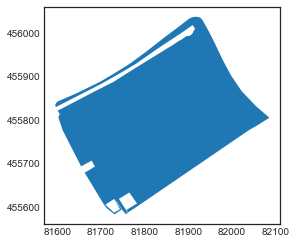

In [47]:
interesting_high_edu_cld[interesting_high_edu_cld['area']>110594].plot()

In [48]:
len(greenspaces[greenspaces['area']>110594])

105

In [49]:
# greenspaces scoring higher on otm than on res&edu
interesting_high_otm_cld = greenspaces[
    (greenspaces['otmC_class']>greenspaces['resC_class']) &
    (greenspaces['otmC_class']>greenspaces['eduC_class'])]

# greenspaces scoring lower on otm than on res&edu
interesting_low_otm_cld = greenspaces[
    (greenspaces['otmC_class']<greenspaces['resC_class']) &
    (greenspaces['otmC_class']<greenspaces['eduC_class'])]

# greenspaces scoring lower on otm than on res&edu AND highest quantile in size
interesting_low_otm_cld_large = greenspaces[
    (greenspaces['otmC_class']<greenspaces['resC_class']) &
    (greenspaces['otmC_class']<greenspaces['eduC_class']) &
    (greenspaces['area']>area_quantiles[0.75])]

In [50]:
print('all greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(greenspaces), greenspaces.area.mean(), greenspaces.area.median(), greenspaces.area.std(), greenspaces.area.min(), greenspaces.area.max()))
print('high-otm greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_high_otm_cld), interesting_high_otm_cld.area.mean(), interesting_high_otm_cld.area.median(), interesting_high_otm_cld.area.std(), interesting_high_otm_cld.area.min(), interesting_high_otm_cld.area.max()))
print('low-otm greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_low_otm_cld), interesting_low_otm_cld.area.mean(), interesting_low_otm_cld.area.median(), interesting_low_otm_cld.area.std(), interesting_low_otm_cld.area.min(), interesting_low_otm_cld.area.max()))
print('low-otm and large greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_low_otm_cld_large), interesting_low_otm_cld_large.area.mean(), interesting_low_otm_cld_large.area.median(), interesting_low_otm_cld_large.area.std(), interesting_low_otm_cld_large.area.min(), interesting_low_otm_cld_large.area.max()))

all greenspaces
n: 848
mean: 67656.95469922815
median: 18505.966121192636
std.dev.: 171846.18145518206
min: 5009.000732979908
max: 2361791.138370567

high-otm greenspaces
n: 37
mean: 20976.49653746934
median: 16197.61504494206
std.dev.: 17347.0675441083
min: 5323.969296865448
max: 95052.04082309919

low-otm greenspaces
n: 249
mean: 82558.61715952652
median: 18946.39848277317
std.dev.: 217949.7736023764
min: 5009.000732979908
max: 2361791.138370567

low-otm and large greenspaces
n: 68
mean: 260076.05012357075
median: 133869.9082031573
std.dev.: 362701.3413457067
min: 42998.19551392555
max: 2361791.138370567



In [51]:
n = 10
candidates = greenspaces[(greenspaces['resC_class']>0) & (greenspaces['eduC_class']>0)]
minsize = candidates.area.nlargest(n=n).min()
candidates = candidates[candidates.area>=minsize]

In [52]:
print(str(round(100*len(
    candidates[(candidates['otmC_class']<candidates['resC_class']) & (candidates['otmC_class']<candidates['eduC_class'])]
)/len(candidates))) + '%')

80%


## plots children

In [53]:
import warnings
warnings.simplefilter('ignore')

In [54]:
cities = ('Amsterdam', 'Rotterdam', 'The Hague')

In [55]:
fontsize_1 = 80
fontsize_2 = 60
fontsize_3 = 50
fontsize_4 = 40

In [56]:
ams_cld_centerpoint = Point(127500, 485000)
ams_cld_highlights = greenspaces[greenspaces.index==320]
rtd_cld_centerpoint = Point(92500, 437000)
rtd_cld_highlights = interesting_high_edu_cld[interesting_high_edu_cld['city']=='Rotterdam']
hag_cld_centerpoint = Point(80500, 457300)
hag_cld_highlights = greenspaces[greenspaces.index.isin([839, 844, 823, 808, 810, 811])]

In [57]:
ams_plot_width = ams_place.total_bounds[2]-800 - ams_place.total_bounds[0]+800
rtd_plot_width = rtd_place.total_bounds[2]-800 - rtd_place.total_bounds[0]+800
hag_plot_width = hag_place.total_bounds[2]-800 - hag_place.total_bounds[0]+800

plot_widths = [ams_plot_width, rtd_plot_width, hag_plot_width, 10000]

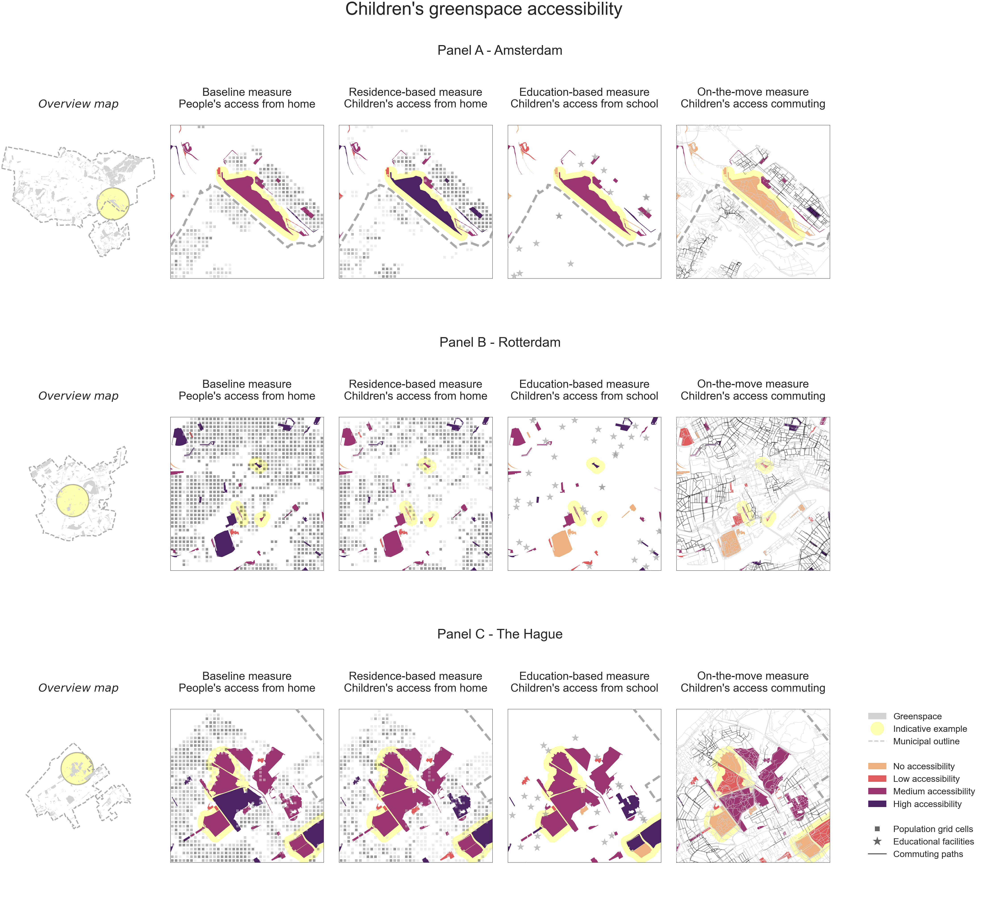

In [58]:
fig = plt.figure(figsize=(80,70))
fig.suptitle('Children\'s greenspace accessibility', fontsize=fontsize_1, y=0.94)
fig.subplots_adjust(hspace=0.15)

# blocks above each other
gs_total = gridspec.GridSpec(3, 1, figure=fig, hspace=0.1, wspace=0.1)

# settings for full-city overview maps
alpha = 0.3
fill = my_highlight
edge = 'black'
linestyle = '-'
gs_color = my_grey


# -------------------------------------------------------------------------------
# block 1, Amsterdam
# -------------------------------------------------------------------------------
gs1 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[0], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs1[0]), 'Amsterdam', ams_greenspaces, ams_place, ams_cld_centerpoint)

plot_res(fig.add_subplot(gs1[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='Amsterdam'], ams_residences, ams_place, interesting=ams_cld_highlights, centerpoint=ams_cld_centerpoint)
plot_res(fig.add_subplot(gs1[2]), 'resC_class', 'children', greenspaces[greenspaces['city']=='Amsterdam'], ams_residences, ams_place, interesting=ams_cld_highlights, centerpoint=ams_cld_centerpoint)
plot_edu(fig.add_subplot(gs1[3]), 'eduC_class', 'children', greenspaces[greenspaces['city']=='Amsterdam'], ams_educational_cld, ams_place, interesting=ams_cld_highlights, centerpoint=ams_cld_centerpoint)
plot_otm(fig.add_subplot(gs1[4]), 'otmC_class', 'children', greenspaces[greenspaces['city']=='Amsterdam'], ams_paths_simplified, ams_place, interesting=ams_cld_highlights, centerpoint=ams_cld_centerpoint)

# -------------------------------------------------------------------------------
# block 2, Rotterdam
# -------------------------------------------------------------------------------
gs2 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[1], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs2[0]), 'Rotterdam', rtd_greenspaces, rtd_place, rtd_cld_centerpoint)

plot_res(fig.add_subplot(gs2[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='Rotterdam'], rtd_residences, rtd_place, interesting=rtd_cld_highlights, centerpoint=rtd_cld_centerpoint)
plot_res(fig.add_subplot(gs2[2]), 'resC_class', 'children', greenspaces[greenspaces['city']=='Rotterdam'], rtd_residences, rtd_place, interesting=rtd_cld_highlights, centerpoint=rtd_cld_centerpoint)
plot_edu(fig.add_subplot(gs2[3]), 'eduC_class', 'children', greenspaces[greenspaces['city']=='Rotterdam'], rtd_educational_cld, rtd_place, interesting=rtd_cld_highlights, centerpoint=rtd_cld_centerpoint)
plot_otm(fig.add_subplot(gs2[4]), 'otmC_class', 'children', greenspaces[greenspaces['city']=='Rotterdam'], rtd_paths_simplified, rtd_place, interesting=rtd_cld_highlights, centerpoint=rtd_cld_centerpoint)


# -------------------------------------------------------------------------------
# block 3, The Hague
# -------------------------------------------------------------------------------
gs3 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[2], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs3[0]), 'The Hague', hag_greenspaces, hag_place, hag_cld_centerpoint)

plot_res(fig.add_subplot(gs3[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='The Hague'], hag_residences, hag_place, interesting=hag_cld_highlights, centerpoint=hag_cld_centerpoint)
plot_res(fig.add_subplot(gs3[2]), 'resC_class', 'children', greenspaces[greenspaces['city']=='The Hague'], hag_residences, hag_place, interesting=hag_cld_highlights, centerpoint=hag_cld_centerpoint)
plot_edu(fig.add_subplot(gs3[3]), 'eduC_class', 'children', greenspaces[greenspaces['city']=='The Hague'], hag_educational_cld, hag_place, interesting=hag_cld_highlights, centerpoint=hag_cld_centerpoint)
plot_otm(fig.add_subplot(gs3[4]), 'otmC_class', 'children', greenspaces[greenspaces['city']=='The Hague'], hag_paths_simplified, hag_place, interesting=hag_cld_highlights, centerpoint=hag_cld_centerpoint)

plot_overalllegend(fig.add_subplot(gs3[5]), fontsize_4)



# -------------------------------------------------------------------------------
# titles and other settings
# -------------------------------------------------------------------------------
subtitle_list = [
    '$Overview$ $map$',
    'Baseline measure\nPeople\'s access from home', 
    'Residence-based measure\nChildren\'s access from home', 
    'Education-based measure\nChildren\'s access from school', 
    'On-the-move measure\nChildren\'s access commuting']

ax1 = fig.add_subplot(gs1[:])
ax1.axis('off')
ax1.set_title('Panel A - Amsterdam', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs1[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')

ax2 = fig.add_subplot(gs2[:])
ax2.axis('off')
ax2.set_title('Panel B - Rotterdam', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs2[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')

ax3 = fig.add_subplot(gs3[:])
ax3.axis('off')
ax3.set_title('Panel C - The Hague', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs3[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')



fig.show()

## Interesting examples adolescents

In [59]:
# greenspaces scoring higher on edu than res
interesting_high_edu_adl = greenspaces[greenspaces['eduA_class']>greenspaces['resA_class']]

# greenspaces scoring lower on edu than res
interesting_low_edu_adl = greenspaces[greenspaces['eduA_class']<greenspaces['resA_class']]

# greenspaces scoring lower on edu than all others
interesting_low_edu_adl_2 = greenspaces[
    (greenspaces['eduA_class']<greenspaces['base_class']) & 
    (greenspaces['eduA_class']<greenspaces['resA_class']) & 
    (greenspaces['eduA_class']<greenspaces['otmA_class'])]

In [60]:
# greenspaces scoring 0 on edu and smaller than res
interesting_0_edu_adl = greenspaces[
    (greenspaces['eduA_class']<greenspaces['resA_class']) &
    (greenspaces['eduA_class']==0)]

In [61]:
print('all greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(greenspaces), greenspaces.area.mean(), greenspaces.area.median(), greenspaces.area.std(), greenspaces.area.min(), greenspaces.area.max()))
print('high-edu greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_high_edu_adl), interesting_high_edu_adl.area.mean(), interesting_high_edu_adl.area.median(), interesting_high_edu_adl.area.std(), interesting_high_edu_adl.area.min(), interesting_high_edu_adl.area.max()))
print('low-edu greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_low_edu_adl), interesting_low_edu_adl.area.mean(), interesting_low_edu_adl.area.median(), interesting_low_edu_adl.area.std(), interesting_low_edu_adl.area.min(), interesting_low_edu_adl.area.max()))

all greenspaces
n: 848
mean: 67656.95469922815
median: 18505.966121192636
std.dev.: 171846.18145518206
min: 5009.000732979908
max: 2361791.138370567

high-edu greenspaces
n: 35
mean: 45886.55887406376
median: 16422.357161234006
std.dev.: 71044.76294891267
min: 5031.675960073326
max: 282173.7783930914

low-edu greenspaces
n: 600
mean: 53929.572372661845
median: 17337.394597905237
std.dev.: 134964.8596314893
min: 5055.769045671262
max: 1672041.905175776



In [62]:
# greenspaces scoring higher on otm than on res&edu
interesting_high_otm_adl = greenspaces[
    (greenspaces['otmA_class']>greenspaces['resA_class']) &
    (greenspaces['otmA_class']>greenspaces['eduA_class'])]

# greenspaces scoring lower on otm than on res&edu
interesting_low_otm_adl = greenspaces[
    (greenspaces['otmA_class']<greenspaces['resA_class']) &
    (greenspaces['otmA_class']<greenspaces['eduA_class'])]

In [63]:
print('all greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(greenspaces), greenspaces.area.mean(), greenspaces.area.median(), greenspaces.area.std(), greenspaces.area.min(), greenspaces.area.max()))
print('high-otm greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_high_otm_adl), interesting_high_otm_adl.area.mean(), interesting_high_otm_adl.area.median(), interesting_high_otm_adl.area.std(), interesting_high_otm_adl.area.min(), interesting_high_otm_adl.area.max()))
print('low-otm greenspaces\nn: {}\nmean: {}\nmedian: {}\nstd.dev.: {}\nmin: {}\nmax: {}\n'.format(len(interesting_low_otm_adl), interesting_low_otm_adl.area.mean(), interesting_low_otm_adl.area.median(), interesting_low_otm_adl.area.std(), interesting_low_otm_adl.area.min(), interesting_low_otm_adl.area.max()))

all greenspaces
n: 848
mean: 67656.95469922815
median: 18505.966121192636
std.dev.: 171846.18145518206
min: 5009.000732979908
max: 2361791.138370567

high-otm greenspaces
n: 10
mean: 34860.42667100482
median: 23522.762916154592
std.dev.: 36426.820635153475
min: 5742.930218419768
max: 131277.33280015888

low-otm greenspaces
n: 142
mean: 99750.41176232367
median: 16543.987113066745
std.dev.: 256069.28005707625
min: 5009.000732979908
max: 2361791.138370567



In [64]:
# areas with traverse movement, but no greenspace near
ams_interesting_paths = gpd.clip(ams_paths_simplified[ams_paths_simplified['betw_adl_800_dr12']>0], ams_place.buffer(-800))
ams_interesting_adl_otm = gpd.overlay(ams_interesting_paths, gpd.GeoDataFrame(geometry=ams_greenspaces.geometry.buffer(500), crs=local_crs), how='difference')

rtd_interesting_paths = gpd.clip(rtd_paths_simplified[rtd_paths_simplified['betw_adl_800_dr12']>0], rtd_place.buffer(-800))
rtd_interesting_adl_otm = gpd.overlay(rtd_interesting_paths, gpd.GeoDataFrame(geometry=rtd_greenspaces.geometry.buffer(500), crs=local_crs), how='difference')

hag_interesting_paths = gpd.clip(hag_paths_simplified[hag_paths_simplified['betw_adl_800_dr12']>0], hag_place.buffer(-800))
hag_interesting_adl_otm = gpd.overlay(hag_interesting_paths, gpd.GeoDataFrame(geometry=hag_greenspaces.geometry.buffer(500), crs=local_crs), how='difference')

## plots adolescents

In [65]:
ams_adl_centerpoint = Point(115000, 487500)
ams_adl_highlights = greenspaces[greenspaces.index==381]
rtd_adl_centerpoint = Point(92500, 438000)
rtd_adl_highlights = rtd_interesting_adl_otm
hag_adl_centerpoint = Point(80000, 454000)
hag_adl_highlights = interesting_low_edu_adl_2

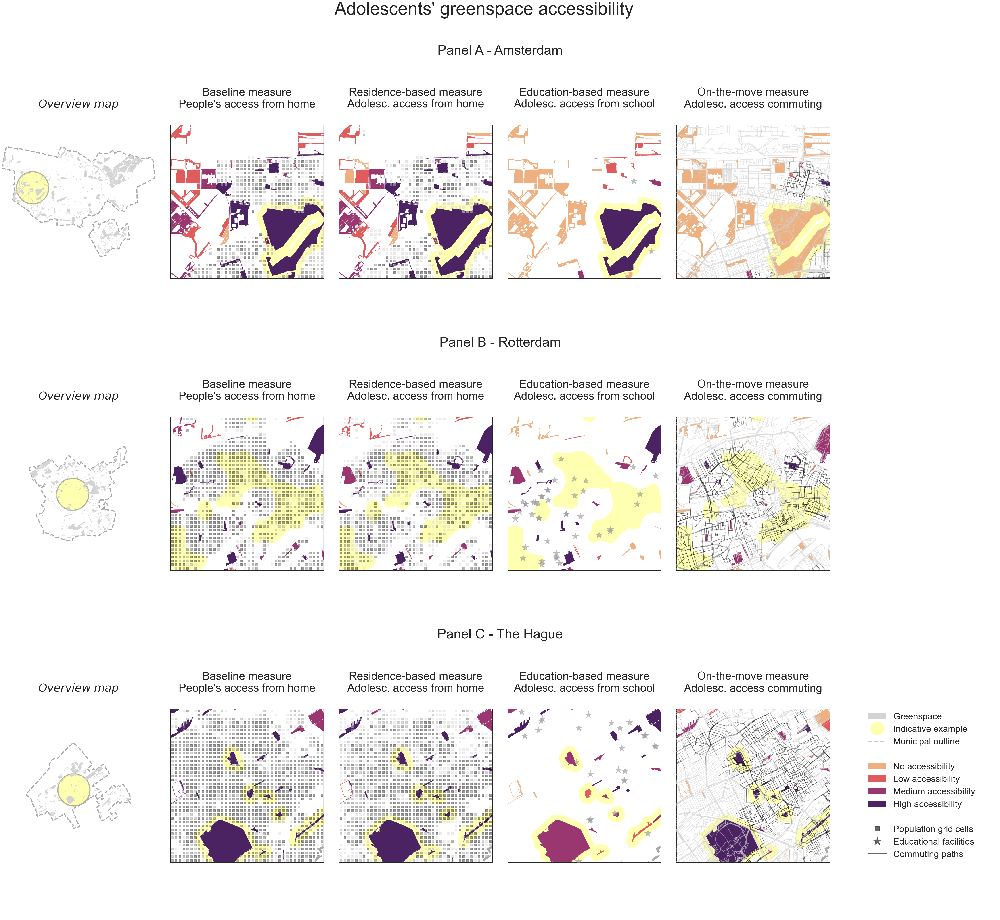

In [66]:
fig = plt.figure(figsize=(80,70))
fig.suptitle('Adolescents\' greenspace accessibility', fontsize=fontsize_1, y=0.94)
fig.subplots_adjust(hspace=0.15)

# blocks above each other
gs_total = gridspec.GridSpec(3, 1, figure=fig, hspace=0.1, wspace=0.1)

# settings for full-city overview maps
alpha = 0.3
fill = my_highlight
edge = 'black'
linestyle = '-'
gs_color = my_grey


# -------------------------------------------------------------------------------
# block 1, Amsterdam
# -------------------------------------------------------------------------------
gs1 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[0], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs1[0]), 'Amsterdam', ams_greenspaces, ams_place, ams_adl_centerpoint)

plot_res(fig.add_subplot(gs1[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='Amsterdam'], ams_residences, ams_place, interesting=ams_adl_highlights, centerpoint=ams_adl_centerpoint)
plot_res(fig.add_subplot(gs1[2]), 'resA_class', 'adolescents', greenspaces[greenspaces['city']=='Amsterdam'], ams_residences, ams_place, interesting=ams_adl_highlights, centerpoint=ams_adl_centerpoint)
plot_edu(fig.add_subplot(gs1[3]), 'eduA_class', 'adolescents', greenspaces[greenspaces['city']=='Amsterdam'], ams_educational_adl, ams_place, interesting=ams_adl_highlights, centerpoint=ams_adl_centerpoint)
plot_otm(fig.add_subplot(gs1[4]), 'otmA_class', 'adolescents', greenspaces[greenspaces['city']=='Amsterdam'], ams_paths_simplified, ams_place, interesting=ams_adl_highlights, centerpoint=ams_adl_centerpoint)

# -------------------------------------------------------------------------------
# block 2, Rotterdam
# -------------------------------------------------------------------------------
gs2 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[1], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs2[0]), 'Rotterdam', rtd_greenspaces, rtd_place, rtd_adl_centerpoint)

plot_res(fig.add_subplot(gs2[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='Rotterdam'], rtd_residences, rtd_place, interesting=rtd_adl_highlights, centerpoint=rtd_adl_centerpoint)
plot_res(fig.add_subplot(gs2[2]), 'resA_class', 'adolescents', greenspaces[greenspaces['city']=='Rotterdam'], rtd_residences, rtd_place, interesting=rtd_adl_highlights, centerpoint=rtd_adl_centerpoint)
plot_edu(fig.add_subplot(gs2[3]), 'eduA_class', 'adolescents', greenspaces[greenspaces['city']=='Rotterdam'], rtd_educational_adl, rtd_place, interesting=rtd_adl_highlights, centerpoint=rtd_adl_centerpoint)
plot_otm(fig.add_subplot(gs2[4]), 'otmA_class', 'adolescents', greenspaces[greenspaces['city']=='Rotterdam'], rtd_paths_simplified, rtd_place, interesting=rtd_adl_highlights, centerpoint=rtd_adl_centerpoint)


# -------------------------------------------------------------------------------
# block 3, The Hague
# -------------------------------------------------------------------------------
gs3 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[2], hspace=0.1, wspace=0.1)

plot_overviewmap(fig.add_subplot(gs3[0]), 'The Hague', hag_greenspaces, hag_place, hag_adl_centerpoint)

plot_res(fig.add_subplot(gs3[1]), 'base_class', 'people', greenspaces[greenspaces['city']=='The Hague'], hag_residences, hag_place, interesting=hag_adl_highlights, centerpoint=hag_adl_centerpoint)
plot_res(fig.add_subplot(gs3[2]), 'resA_class', 'adolescents', greenspaces[greenspaces['city']=='The Hague'], hag_residences, hag_place, interesting=hag_adl_highlights, centerpoint=hag_adl_centerpoint)
plot_edu(fig.add_subplot(gs3[3]), 'eduA_class', 'adolescents', greenspaces[greenspaces['city']=='The Hague'], hag_educational_adl, hag_place, interesting=hag_adl_highlights, centerpoint=hag_adl_centerpoint)
plot_otm(fig.add_subplot(gs3[4]), 'otmA_class', 'adolescents', greenspaces[greenspaces['city']=='The Hague'], hag_paths_simplified, hag_place, interesting=hag_adl_highlights, centerpoint=hag_adl_centerpoint)

plot_overalllegend(fig.add_subplot(gs3[5]), fontsize_4)


# -------------------------------------------------------------------------------
# titles and other settings
# -------------------------------------------------------------------------------
subtitle_list = [
    '$Overview$ $map$',
    'Baseline measure\nPeople\'s access from home', 
    'Residence-based measure\nAdolesc. access from home', 
    'Education-based measure\nAdolesc. access from school', 
    'On-the-move measure\nAdolesc. access commuting']

ax1 = fig.add_subplot(gs1[:])
ax1.axis('off')
ax1.set_title('Panel A - Amsterdam', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs1[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')

ax2 = fig.add_subplot(gs2[:])
ax2.axis('off')
ax2.set_title('Panel B - Rotterdam', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs2[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')

ax3 = fig.add_subplot(gs3[:])
ax3.axis('off')
ax3.set_title('Panel C - The Hague', fontsize=fontsize_2, y=1.05) # higher is up, # lower down
for i in range(len(subtitle_list)):
    ax = fig.add_subplot(gs3[i])
    ax.set_title(subtitle_list[i], fontsize=fontsize_3, y=0.85)
    ax.axis('off')



fig.show()

# Indicative examples

In [77]:
def plot_all(ax, col, group, index, radius, greenspaces, quantiles, residences, educational, paths):
    
    if group == 'children':
        res_col = 'cld_count'
        path_col = 'betw_cld_800_dr12'
    elif group == 'adolescents':
        res_col = 'adl_count'
        path_col = 'betw_adl_800_dr12'

    greenspace = greenspaces.iloc[[index]]
    iso = greenspace.set_geometry('geom_iso_800')
    
    if greenspace[col][index]==0:
        greenspace.plot(ax=ax, color=my_neutral, zorder=7)
        iso.plot(ax=ax, color=my_neutral, zorder=6, alpha=0.3)
    elif greenspace[col][index]==1:
        greenspace.plot(ax=ax, color=seq_cmap(0.333), zorder=7)
        iso.plot(ax=ax, color=seq_cmap(0.333), zorder=6, alpha=0.3)
    elif greenspace[col][index]==2:
        greenspace.plot(ax=ax, color=seq_cmap(0.666), zorder=7)
        iso.plot(ax=ax, color=seq_cmap(0.666), zorder=6, alpha=0.3)
    elif greenspace[col][index]==3:
        greenspace.plot(ax=ax, color=seq_cmap(1.0), zorder=7)
        iso.plot(ax=ax, color=seq_cmap(1.0), zorder=6, alpha=0.3)
    
    if paths is not None:
        if 'otm' in col:
            paths.plot(ax=ax, color=my_grey, linewidth=4, alpha=0.2, zorder=7)
            paths[paths[path_col]>0].plot(ax=ax, column=path_col, cmap='Greys', scheme='quantiles', linewidth=4, alpha=1, zorder=7)
        else:
            paths.plot(ax=ax, color='black', linewidth=2, alpha=0.4, zorder=7)
    
    markersize = 400
    if residences is not None:
        residences[residences[res_col]==0].plot(ax=ax, marker='s', facecolor='None', edgecolor='white', zorder=4, markersize=markersize, alpha=0.5)
        residences[residences[res_col]>0].plot(ax=ax, marker='s', column=res_col, scheme='quantiles', cmap='Greys', facecolor='None', alpha=0.5, zorder=4, markersize=markersize)
    
    if educational is not None:
        educational.plot(ax=ax, color='black', marker='*', markersize=3*markersize, alpha=1, zorder=8)

    centroid = greenspace.geometry.centroid[index]
    margin = radius
    xlim = ([centroid.x-radius, centroid.x+radius])
    ylim = ([centroid.y-radius, centroid.y+radius])
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.axis("off")
    ax.set_anchor('N')
    
    cx.add_basemap(ax, crs=local_crs, source=cx.providers.OpenStreetMap.Mapnik, alpha=0.5, zorder=0)
    
    return centroid.buffer(radius)

In [78]:
# high res compared to edu, cld - small ones
weteringplantsoen = 228
leuvehoofd = 507
stadhoudersplantsoen = 819

# high res compared to edu, cld - open surroundings
gaasperzoom = 22
oudeplantage = 514
malieveld = 810

# low otm compared to res and edu, cld - either large
sloterpark = 381
kralingsebos = 536
haagsebos = 811

# low otm compared to res and edu, cld - open surroundings
westerpark = 144
vroesenpark = 542
westbroekpark = 844

In [79]:
def plot_overalllegend(ax, fontsize):

    handles = [
        mpatches.Patch(color='lightgrey', label='Greenspace'),
        mlines.Line2D([], [], color=my_highlight, alpha=0.3, marker='o', linestyle='None', markersize=60, label='Indicative example'),
        mlines.Line2D([], [], color=my_outline, alpha=0.6, linestyle='--', linewidth=5, label='Municipal outline'),
        
        mpatches.Patch(color='None'),
        mpatches.Patch(color='None'),
        mpatches.Patch(color='None'),
        mpatches.Patch(color='None'),
        mpatches.Patch(color='None'),
        
        mpatches.Patch(color=my_neutral, label='No accessibility'),
        mpatches.Patch(color=seq_cmap(0.333), label='Low accessibility'),
        mpatches.Patch(color=seq_cmap(0.666), label='Medium accessibility'),
        mpatches.Patch(color=seq_cmap(1.0), label='High accessibility'),
        mpatches.Patch(color='None', label='& surrounding walkshed', alpha=0.3),
        mpatches.Patch(color='None', label='in semi-transparent color', alpha=0.3),
        mlines.Line2D([], [], color='black', marker='s', linestyle='None', markersize=20, alpha=0.6, label='Population grid cells'),
        mlines.Line2D([], [], color='black', marker='*', linestyle='None', markersize=40, alpha=0.6, label='Educational facilities'),
        mlines.Line2D([], [], color='black', alpha=0.6, linestyle='-', linewidth=5, label='Commuting paths')]
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='upper right',
        title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'
    
    ax.axis("off")

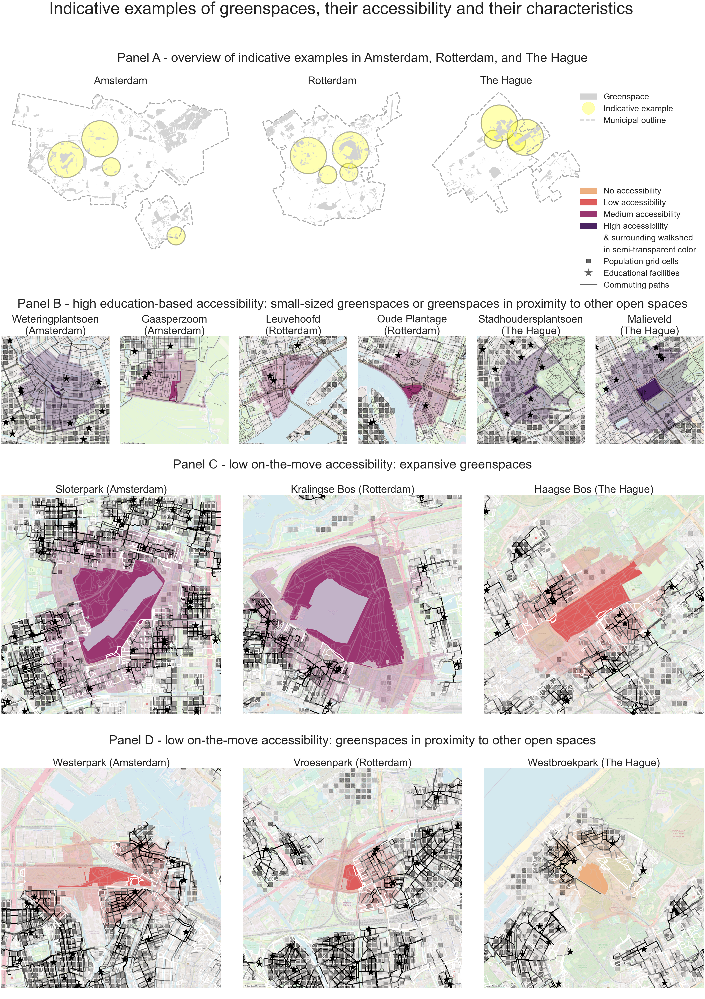

In [82]:
fig = plt.figure(figsize=(60,80))
fig.suptitle('Indicative examples of greenspaces, their accessibility and their characteristics', fontsize=fontsize_1, y=0.95)
fig.subplots_adjust(hspace=0.15)

# 4 blocks above each other
gs_total = gridspec.GridSpec(
    4, 1, figure=fig, hspace=0.1, wspace=0.1,
    height_ratios=[2, 1.2, 2.2, 2])



# -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   
# block 1, high edu and small or in open surroundings
gs1 = gridspec.GridSpecFromSubplotSpec(1, 6, subplot_spec=gs_total[1], hspace=0.1, wspace=0.1)
col = 'eduC_class'
group = 'children'
quantiles = eduC_quantiles
gs1ax0 = fig.add_subplot(gs1[0])
weteringplantsoen_place = plot_all(gs1ax0, col, group, weteringplantsoen, 1000, greenspaces, quantiles, ams_residences, ams_educational_cld, ams_paths_simplified)
gs1ax0.set_title('Weteringplantsoen\n(Amsterdam)', fontsize=fontsize_3)
gs1ax1 = fig.add_subplot(gs1[1])
gaasperzoom_place = plot_all(gs1ax1, col, group, gaasperzoom, 1000, greenspaces, quantiles, ams_residences, ams_educational_cld, ams_paths_simplified)
gs1ax1.set_title('Gaasperzoom\n(Amsterdam)', fontsize=fontsize_3)
gs1ax2 = fig.add_subplot(gs1[2])
leuvehoofd_place = plot_all(gs1ax2, col, group, leuvehoofd, 1000, greenspaces, quantiles, rtd_residences, rtd_educational_cld, rtd_paths_simplified)
gs1ax2.set_title('Leuvehoofd\n(Rotterdam)', fontsize=fontsize_3)
gs1ax3 = fig.add_subplot(gs1[3])
oudeplantage_place = plot_all(gs1ax3, col, group, oudeplantage, 1000, greenspaces, quantiles, rtd_residences, rtd_educational_cld, rtd_paths_simplified)
gs1ax3.set_title('Oude Plantage\n(Rotterdam)', fontsize=fontsize_3)
gs1ax4 = fig.add_subplot(gs1[4])
stadhoudersplantsoen_place = plot_all(gs1ax4, col, group, stadhoudersplantsoen, 1000, greenspaces, quantiles, hag_residences, hag_educational_cld, hag_paths_simplified)
gs1ax4.set_title('Stadhoudersplantsoen\n(The Hague)', fontsize=fontsize_3)
gs1ax5 = fig.add_subplot(gs1[5])
malieveld_place = plot_all(gs1ax5, col, group, malieveld, 1000, greenspaces, quantiles, hag_residences, hag_educational_cld, hag_paths_simplified)
gs1ax5.set_title('Malieveld\n(The Hague)', fontsize=fontsize_3)


# -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   
# block 2, low otm and large
gs3 = gridspec.GridSpecFromSubplotSpec(1, 3, subplot_spec=gs_total[2], hspace=0.1, wspace=0.1)
col = 'otmC_class'
group = 'children'
quantiles = otmsC_quantiles
gs3ax0 = fig.add_subplot(gs3[0])
sloterplas_place = plot_all(gs3ax0, col, group, sloterpark, 2000, greenspaces, quantiles, ams_residences, ams_educational_cld, ams_paths_simplified)
gs3ax0.set_title('Sloterpark (Amsterdam)', fontsize=fontsize_3)
gs3ax1 = fig.add_subplot(gs3[1])
kralingsebos_place = plot_all(gs3ax1, col, group, kralingsebos, 2000, greenspaces, quantiles, rtd_residences, rtd_educational_cld, rtd_paths_simplified)
gs3ax1.set_title('Kralingse Bos (Rotterdam)', fontsize=fontsize_3)
gs3ax2 = fig.add_subplot(gs3[2])
haagsebos_place = plot_all(gs3ax2, col, group, haagsebos, 2000, greenspaces, quantiles, hag_residences, hag_educational_cld, hag_paths_simplified)
gs3ax2.set_title('Haagse Bos (The Hague)', fontsize=fontsize_3)


# -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   
# block 3, low otm in open surroundings
gs4 = gridspec.GridSpecFromSubplotSpec(1, 3, subplot_spec=gs_total[3], hspace=0.1, wspace=0.1)
col = 'otmC_class'
group = 'children'
quantiles = otmsC_quantiles
gs4ax0 = fig.add_subplot(gs4[0])
westerpark_place = plot_all(gs4ax0, col, group, westerpark, 2000, greenspaces, quantiles, ams_residences, ams_educational_cld, ams_paths_simplified)
gs4ax0.set_title('Westerpark (Amsterdam)', fontsize=fontsize_3)
gs4ax1 = fig.add_subplot(gs4[1])
vroesenpark_place = plot_all(gs4ax1, col, group, vroesenpark, 2000, greenspaces, quantiles, rtd_residences, rtd_educational_cld, rtd_paths_simplified)
gs4ax1.set_title('Vroesenpark (Rotterdam)', fontsize=fontsize_3)
gs4ax2 = fig.add_subplot(gs4[2])
westbroekpark_place = plot_all(gs4ax2, col, group, westbroekpark, 2000, greenspaces, quantiles, hag_residences, hag_educational_cld, hag_paths_simplified)
gs4ax2.set_title('Westbroekpark (The Hague)', fontsize=fontsize_3)


# -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   
# block 0, context and legend
gs0 = gridspec.GridSpecFromSubplotSpec(1, 4, subplot_spec=gs_total[0], hspace=0.1, wspace=0.1, width_ratios=plot_widths)
alpha = 0.3
fill = my_highlight
edge = 'black'
linestyle = '-'
gs_color = my_grey

gs0ax0 = fig.add_subplot(gs0[0])
ams_greenspaces.plot(ax=gs0ax0, color=gs_color, zorder=5)
ams_place.plot(ax=gs0ax0, facecolor='none', edgecolor=my_outline, linewidth=5, linestyle='--', zorder=4)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[weteringplantsoen_place])).plot(ax=gs0ax0, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[gaasperzoom_place])).plot(ax=gs0ax0, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[sloterplas_place])).plot(ax=gs0ax0, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[westerpark_place])).plot(ax=gs0ax0, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
gs0ax0.set_title('Amsterdam', fontsize=fontsize_3)
gs0ax0.axis('off')
gs0ax0.set_anchor('N')

gs0ax1 = fig.add_subplot(gs0[1])
rtd_greenspaces.plot(ax=gs0ax1, color=gs_color, zorder=5)
rtd_place.plot(ax=gs0ax1, facecolor='none', edgecolor=my_outline, linewidth=5, linestyle='--', zorder=4)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[leuvehoofd_place])).plot(ax=gs0ax1, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[oudeplantage_place])).plot(ax=gs0ax1, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[kralingsebos_place])).plot(ax=gs0ax1, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[vroesenpark_place])).plot(ax=gs0ax1, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
gs0ax1.set_title('Rotterdam', fontsize=fontsize_3)
gs0ax1.axis('off')
gs0ax1.set_anchor('N')

gs0ax2 = fig.add_subplot(gs0[2])
hag_greenspaces.plot(ax=gs0ax2, color=gs_color, zorder=5)
hag_place.plot(ax=gs0ax2, facecolor='none', edgecolor=my_outline, linewidth=5, linestyle='--', zorder=4)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[stadhoudersplantsoen_place])).plot(ax=gs0ax2, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[malieveld_place])).plot(ax=gs0ax2, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[haagsebos_place])).plot(ax=gs0ax2, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
(gpd.GeoDataFrame(index=[0], crs=local_crs, geometry=[westbroekpark_place])).plot(ax=gs0ax2, color=fill, edgecolor=edge, linewidth=5, alpha=alpha, zorder=3, linestyle=linestyle)
gs0ax2.set_title('The Hague', fontsize=fontsize_3)
gs0ax2.axis('off')
gs0ax2.set_anchor('N')

gs0ax3 = fig.add_subplot(gs0[3])
plot_overalllegend(gs0ax3, fontsize_4)


# -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   -   
# panel titles
ax0 = fig.add_subplot(gs0[:])
ax0.axis('off')
ax0.set_title('Panel A - overview of indicative examples in Amsterdam, Rotterdam, and The Hague', fontsize=fontsize_2, y=1.1) # higher is up, # lower down

ax1 = fig.add_subplot(gs1[:])
ax1.axis('off')
ax1.set_title('Panel B - high education-based accessibility: small-sized greenspaces or greenspaces in proximity to other open spaces', fontsize=fontsize_2, y=1.2) # higher is up, # lower down

ax3 = fig.add_subplot(gs3[:])
ax3.axis('off')
ax3.set_title('Panel C - low on-the-move accessibility: expansive greenspaces', fontsize=fontsize_2, y=1.1) # higher is up, # lower down

ax4 = fig.add_subplot(gs4[:])
ax4.axis('off')
ax4.set_title('Panel D - low on-the-move accessibility: greenspaces in proximity to other open spaces', fontsize=fontsize_2, y=1.1) # higher is up, # lower down

fig.show()

## Children vs. adolescents (EHEN)

In [71]:
style.use('dark_background')

In [72]:
def plot_all(ax, col, group, index, radius, greenspaces, residences, educational, paths):
    
    if group == 'children':
        res_col = 'cld_count'
        path_col = 'betw_cld_800_dr12'
    elif group == 'adolescents':
        res_col = 'adl_count'
        path_col = 'betw_adl_800_dr12'

    greenspace = greenspaces.iloc[[index]]
    greenspace.plot(ax=ax, color='#81BA4E', alpha=0.8, zorder=7)
    
    linewidth = 4
    if paths is not None:
        if 'otm' in col:
            paths.plot(ax=ax, color=my_grey, linewidth=linewidth, alpha=0.2, zorder=7)
            paths[paths[path_col]>0].plot(ax=ax, column=path_col, cmap='plasma', scheme='quantiles', linewidth=linewidth, alpha=1, zorder=7)
        else:
            paths.plot(ax=ax, color='black', linewidth=linewidth, alpha=0.4, zorder=7)
    
    markersize = 1000
    if residences is not None:
        residences[residences[res_col]==0].plot(ax=ax, marker='s', facecolor='None', edgecolor='black', zorder=4, markersize=markersize, alpha=0.5)
        residences[residences[res_col]>0].plot(ax=ax, marker='s', column=res_col, scheme='quantiles', cmap='Greys_r', facecolor='None', alpha=0.5, zorder=4, markersize=markersize)
    
    if educational is not None:
        educational.plot(ax=ax, color='white', marker='*', markersize=3*markersize, alpha=1, zorder=8)

    centroid = greenspace.geometry.centroid[index]
    margin = radius
    xlim = ([centroid.x-radius, centroid.x+radius])
    ylim = ([centroid.y-radius, centroid.y+radius])
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.axis("off")
    ax.set_anchor('N')
    
    return centroid.buffer(radius)

In [73]:
def plot_overalllegend(ax, fontsize):

    handles = [
        
        mlines.Line2D([], [], color='white', marker='s', linestyle='None', markersize=20, alpha=1, label='Residences'),
        mlines.Line2D([], [], color='white', marker='*', linestyle='None', markersize=40, alpha=1, label='Schools'),
        mlines.Line2D([], [], color='white', alpha=1, linestyle='-', linewidth=5, label='Streets')]
    
    leg = ax.legend(
        handles=handles, prop={"size":fontsize}, loc='upper right',
        title_fontsize=fontsize, fontsize=fontsize)
    leg._legend_box.align='left'
    
    ax.axis("off")

In [74]:
oosterpark = 227
rembrandtpark = 392

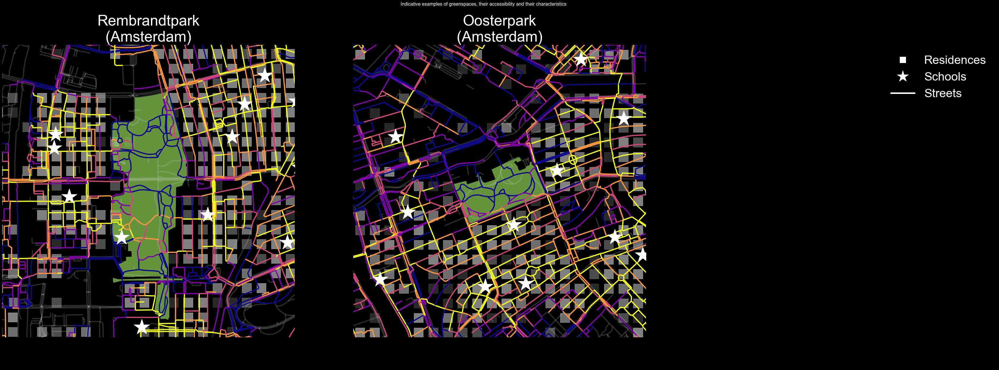

In [75]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(60,20))
fig.suptitle('Indicative examples of greenspaces, their accessibility and their characteristics', fontsize=16)


col = 'otmC_class'
group = 'children'
rembrandtpark_place = plot_all(axs[0], col, group, rembrandtpark, 1000, greenspaces, ams_residences, ams_educational_cld, ams_paths_simplified)
axs[0].set_title('Rembrandtpark\n(Amsterdam)', fontsize=fontsize_3)
oosterpark_place = plot_all(axs[1], col, group, oosterpark, 1000, greenspaces, ams_residences, ams_educational_cld, ams_paths_simplified)
axs[1].set_title('Oosterpark\n(Amsterdam)', fontsize=fontsize_3)
plot_overalllegend(axs[2], fontsize_4)


fig.show()